In [25]:
# ===================
# To make some time series and then investigate the effect of TIMESCALE on the data plotted
# in CO2_Offline_Correlations.ipynb
# ===================

detrend = True
season = 1
testing = False

# Can test with just the 250y period from 2100-2350

In [26]:
import netCDF4
import os
import cartopy.crs as ccrs
import numpy as np
import scipy.interpolate.ndgriddata as ndgriddata
import pickle
import sys
from scipy import stats
import mfilter

data_dir = '/data/mmenary/fgco2'
constant_vars = ['none', 'dpco2', 'sfcWind', 'siconc', 'sos', 'tos']
output_dir = '/home/mmenary/python/notebooks/CO2_Py3x/output'
year0s = [1850, 2100, 2350, 2600, 2850, 3100, 3350, 3600]

nj, ni = 180, 360
lon_re = np.repeat((np.arange(-180, 180) + 0.5)[np.newaxis, :], nj, axis=0)
lat_re = np.repeat((np.arange(-90, 90) + 0.5)[:, None], ni, axis=1)

if season == 0:
    season_string = ''
    season_string2 = '(Annual)'
else:
    season_string = '_Season{:d}'.format(season)
    seasons = ['', 'JFM', 'AMJ', 'JAS', 'OND']
    season_string2 = '({:s})'.format(seasons[season])

def regrid_for_plotting(fld):
    '''
    Regrid for plotting
    '''
    fld_regridded = ndgriddata.griddata((nav_lon.flatten(), nav_lat.flatten()),
                                        fld.flatten(), (lon_re, lat_re), method="linear")
    mask_regridded = ndgriddata.griddata((nav_lon.flatten(), nav_lat.flatten()),
                                         fld.mask.flatten(), (lon_re, lat_re), method="linear")

    fld_regridded = np.ma.array(fld_regridded, mask=mask_regridded)
    
    return fld_regridded

def area_mean(fld, masked_area):
    nt, nj, ni = fld.shape
    area_mean = np.ma.masked_all(shape=nt)
    masked_area_sum = np.ma.sum(masked_area)
    for tt in range(nt):
        area_mean[tt] = np.ma.sum(fld[tt, :, :] * masked_area) / masked_area_sum
    return area_mean

def get_i_j(region):
    if region == 'SPGextended':
        # Extended subpolar gyre
        jj0, jj1 = 245, 300
        ii0, ii1 = 225, 295
    elif region == 'EQPac':
        # Equatorial Pacific
        jj0, jj1 = 171, 201
        ii0, ii1 = 49, 220
    elif region == 'SO':
        # Southern Ocean
        jj0, jj1 = 20, 105
        ii0, ii1 = 0, 360
    elif region == 'Global':
        jj0, jj1 = 0, 331
        ii0, ii1 = 0, 360
    else:
        raise valueError('unknown region')
    return ii0, ii1, jj0, jj1

def detrend_ts(ts):
    trend = mfilter.smooth1d(ts, 71, mask_ends=True)
    trend -= trend.mean()
    detrended = ts - trend
    return detrended

def get_min_max(region, smoothing, constantOrVary='constant'):
    timeSeries_offline = timeSeries_oneConstant[region]['none']       
    timeSeries_online2 = timeSeries_online[region]
    if detrend:
        timeSeries_offline = detrend_ts(timeSeries_offline)
        timeSeries_online2 = detrend_ts(timeSeries_online2)
    if smoothing > 1:
        timeSeries_offline = mfilter.smooth1d(timeSeries_offline, smoothing, mask_ends=True)
        timeSeries_online2 = mfilter.smooth1d(timeSeries_online2, smoothing, mask_ends=True)
    current_min = np.min(np.array((np.min(timeSeries_offline), np.min(timeSeries_online2))))
    current_max = np.max(np.array((np.max(timeSeries_offline), np.max(timeSeries_online2))))
        
    for ivar, var in enumerate(constant_vars):
        if constantOrVary == 'constant':
            timeSeries = timeSeries_oneConstant[region][var]
        elif constantOrVary == 'vary':
            timeSeries = timeSeries_oneVary[region][var]
        else:
            raise ValueError('unknown')
        
        if detrend:
            timeSeries = detrend_ts(timeSeries)
        if smoothing > 1:
            timeSeries = mfilter.smooth1d(timeSeries, smoothing, mask_ends=True)
            
        current_min = np.min(np.array((np.min(timeSeries), current_min)))
        current_max = np.max(np.array((np.max(timeSeries), current_max)))
            
    return [current_min, current_max]

In [27]:
# Should pick some sensible regions
remake_guide_map = False

import matplotlib.pyplot as plt
import matplotlib.tri as tri
from matplotlib.colors import BoundaryNorm
from matplotlib.ticker import MaxNLocator
import matplotlib.gridspec as gridspec
%matplotlib inline

cmap = plt.get_cmap('coolwarm')
levels = np.linspace(-1, 1, 21) / 1e9
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)

fontsize = 20

regions = ['SPGextended', 'EQPac', 'SO', 'Global']

file_name = os.path.join(data_dir, 'fgco2_MonClim.nc')
loaded = netCDF4.Dataset(file_name)
nav_lat = loaded.variables['nav_lat'][:-1, 1:-1]
nav_lon = loaded.variables['nav_lon'][:-1, 1:-1]
area = loaded.variables['area'][:-1, 1:-1]
fgco2_map = loaded.variables['fgco2'][:, :-1, 1:-1].mean(axis=0)

if remake_guide_map:
    fig = plt.figure(figsize=(15, 5))
    fig.patch.set_facecolor('white')
    clevs = plt.pcolormesh(lon_re, lat_re, regrid_for_plotting(fgco2_map), norm=norm, cmap=cmap)
    plt.colorbar(clevs)
    plt.title('Mask regions. fgco2 time mean from file', fontsize=fontsize)

    colors = ['k', 'red', 'blue']
    for iregion, region in enumerate(regions):
        if region == 'Global': continue
        ii0, ii1, jj0, jj1 = get_i_j(region)

        masked = np.ma.masked_all(shape=(nav_lon.shape))
        masked[:] = 1
        masked[:].mask = False
        if region == 'SO':
            masked[:jj0, :].mask = True
            masked[jj1:, :].mask = True
        else:
            masked[:jj0, :].mask = True
            masked[jj1:, :].mask = True
            masked[:, ii1:].mask = True
            masked[:, :ii0].mask = True

        plt.contour(lon_re, lat_re, regrid_for_plotting(masked).mask, colors=['k'])

    plt.xticks(fontsize=fontsize)
    plt.yticks(fontsize=fontsize)

    fig_save_file = '{:s}/CO2_Offline_TimeSeries_MaskRegions.png'
    fig_save_file = fig_save_file.format(output_dir)
    plt.savefig(fig_save_file, bbox_inches = 'tight')
    print(fig_save_file)

In [28]:
nyrs = 2000
years_full = 1850 + np.arange(nyrs)
nyrs_per_file = 250

save_file_areameancorrs = '/data/mmenary/python_saves/CO2_areameancorrs{:s}.pkl'.format(season_string)
if testing: save_file_areameancorrs += '.TEST'
print(save_file_areameancorrs)
if os.path.isfile(save_file_areameancorrs) and not testing:
    with open(save_file_areameancorrs, 'rb') as handle:
        timeSeries_oneConstant, timeSeries_oneVary, timeSeries_online = pickle.load(handle)
else:
    timeSeries_oneConstant, timeSeries_oneVary, timeSeries_online = {}, {}, {}
    for region in regions:
        timeSeries_oneConstant[region] = {}
        timeSeries_oneVary[region] = {}
        for var in constant_vars:
            timeSeries_oneConstant[region][var] = np.ma.masked_all(shape=nyrs)
            timeSeries_oneVary[region][var] = np.ma.masked_all(shape=nyrs)
        timeSeries_online[region] = np.ma.masked_all(shape=nyrs)

    for iregion, region in enumerate(regions):
        print(region)
        ii0, ii1, jj0, jj1 = get_i_j(region)

        for iyr, year0 in enumerate(year0s):
            if testing:
                if year0 != 2100: continue
            tt0 = (year0 - 1850)
            tt1 = tt0 + nyrs_per_file

            for iConstant, oneConstant in enumerate([True, False]):
                year1 = year0 + nyrs_per_file
                if oneConstant:
                    save_file = '/data/mmenary/python_saves/CO2_OneConstant_{:d}-{:d}{:s}.pkl'.format(year0, year1, season_string)
                else:
                    save_file = '/data/mmenary/python_saves/CO2_OneVaries_{:d}-{:d}{:s}.pkl'.format(year0, year1, season_string)

                years = year0 + np.arange(nyrs)

                print(save_file)
                if os.path.isfile(save_file):
                    with open(save_file, 'rb') as handle:
                        if oneConstant:
                            fgco2_ann_oneConstant_in, fgco2_ann_online, nav_lon, nav_lat = pickle.load(handle)

                            if (iyr == 0) or testing:
                                area_masked = np.ma.array(area[jj0:jj1, ii0:ii1],
                                                          mask=fgco2_ann_online[0, jj0:jj1, ii0:ii1].mask)

                            area_masked2 = np.ma.array(area_masked, mask=fgco2_ann_online[0, jj0:jj1, ii0:ii1].mask)
                            timeSeries_online[region][tt0:tt1] = area_mean(fgco2_ann_online[:, jj0:jj1, ii0:ii1], area_masked2)

                            for var in constant_vars:
                                this_var = fgco2_ann_oneConstant_in[var][:, jj0:jj1, ii0:ii1]
                                area_masked2 = np.ma.array(area_masked, mask=this_var[0, :, :].mask)
                                timeSeries_oneConstant[region][var][tt0:tt1] = area_mean(this_var, area_masked2)
                                fgco2_ann_oneConstant_in[var] = 0
                        else:
                            fgco2_ann_oneVary_in, _, nav_lon, nav_lat = pickle.load(handle)
                            for var in constant_vars:
                                this_var = fgco2_ann_oneVary_in[var][:, jj0:jj1, ii0:ii1]
                                area_masked2 = np.ma.array(area_masked, mask=this_var[0, :, :].mask)
                                timeSeries_oneVary[region][var][tt0:tt1] = area_mean(this_var, area_masked2)
                                fgco2_ann_oneVary_in[var] = 0
                else:
                    print('Did not find file')
                    
    with open(save_file_areameancorrs, 'wb') as handle:
        pickle.dump([timeSeries_oneConstant, timeSeries_oneVary, timeSeries_online],
                    handle, protocol=pickle.HIGHEST_PROTOCOL)
print("DONE!")

/data/mmenary/python_saves/CO2_areameancorrs_Season1.pkl
SPGextended
/data/mmenary/python_saves/CO2_OneConstant_1850-2100_Season1.pkl
/data/mmenary/python_saves/CO2_OneVaries_1850-2100_Season1.pkl
/data/mmenary/python_saves/CO2_OneConstant_2100-2350_Season1.pkl
/data/mmenary/python_saves/CO2_OneVaries_2100-2350_Season1.pkl
/data/mmenary/python_saves/CO2_OneConstant_2350-2600_Season1.pkl
/data/mmenary/python_saves/CO2_OneVaries_2350-2600_Season1.pkl
/data/mmenary/python_saves/CO2_OneConstant_2600-2850_Season1.pkl
/data/mmenary/python_saves/CO2_OneVaries_2600-2850_Season1.pkl
/data/mmenary/python_saves/CO2_OneConstant_2850-3100_Season1.pkl
/data/mmenary/python_saves/CO2_OneVaries_2850-3100_Season1.pkl
/data/mmenary/python_saves/CO2_OneConstant_3100-3350_Season1.pkl
/data/mmenary/python_saves/CO2_OneVaries_3100-3350_Season1.pkl
/data/mmenary/python_saves/CO2_OneConstant_3350-3600_Season1.pkl
/data/mmenary/python_saves/CO2_OneVaries_3350-3600_Season1.pkl
/data/mmenary/python_saves/CO2_OneC

/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneConstant_Smoothing1Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneConstant_Smoothing3Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneConstant_Smoothing5Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneConstant_Smoothing7Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneConstant_Smoothing11Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneConstant_Smoothing15Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneConstant_Smoothing21Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextende

/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneConstant_Smoothing11Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneConstant_Smoothing15Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneConstant_Smoothing21Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneConstant_Smoothing31Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneConstant_Smoothing1Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneConstant_Smoothing3Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneConstant_Smoothing5Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneConstant_Smoothing7Y_Detrended71Y_Season1.png
/hom

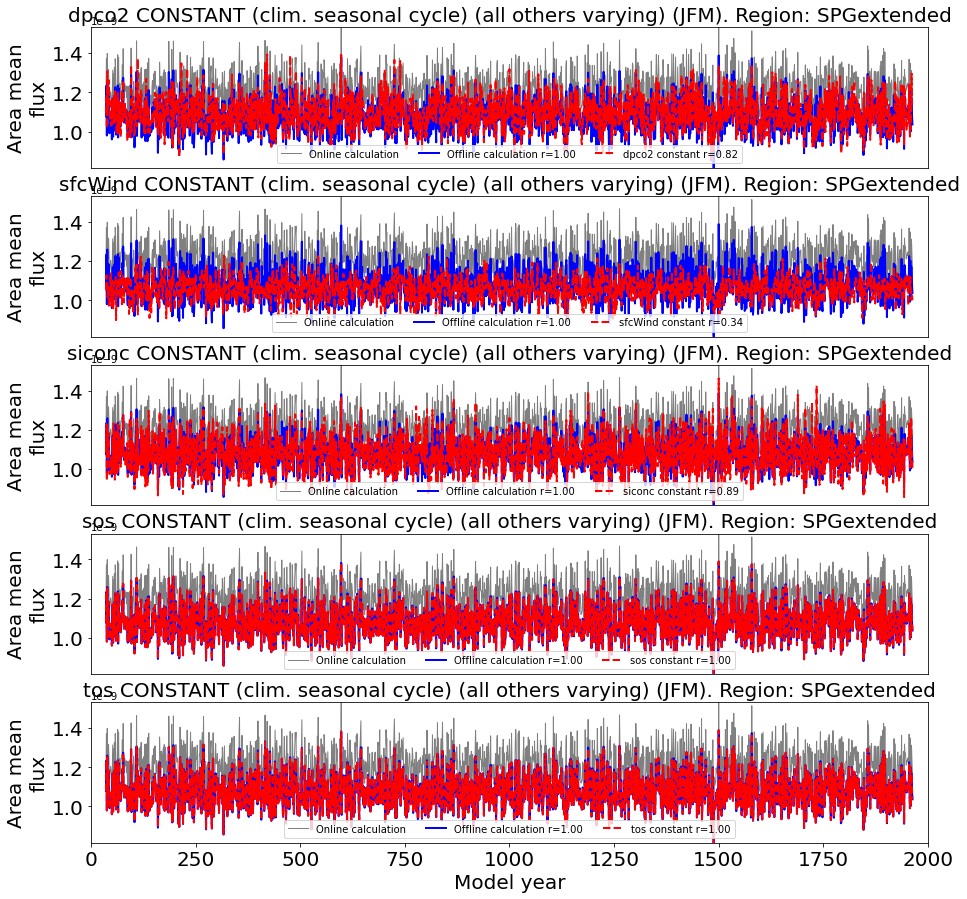

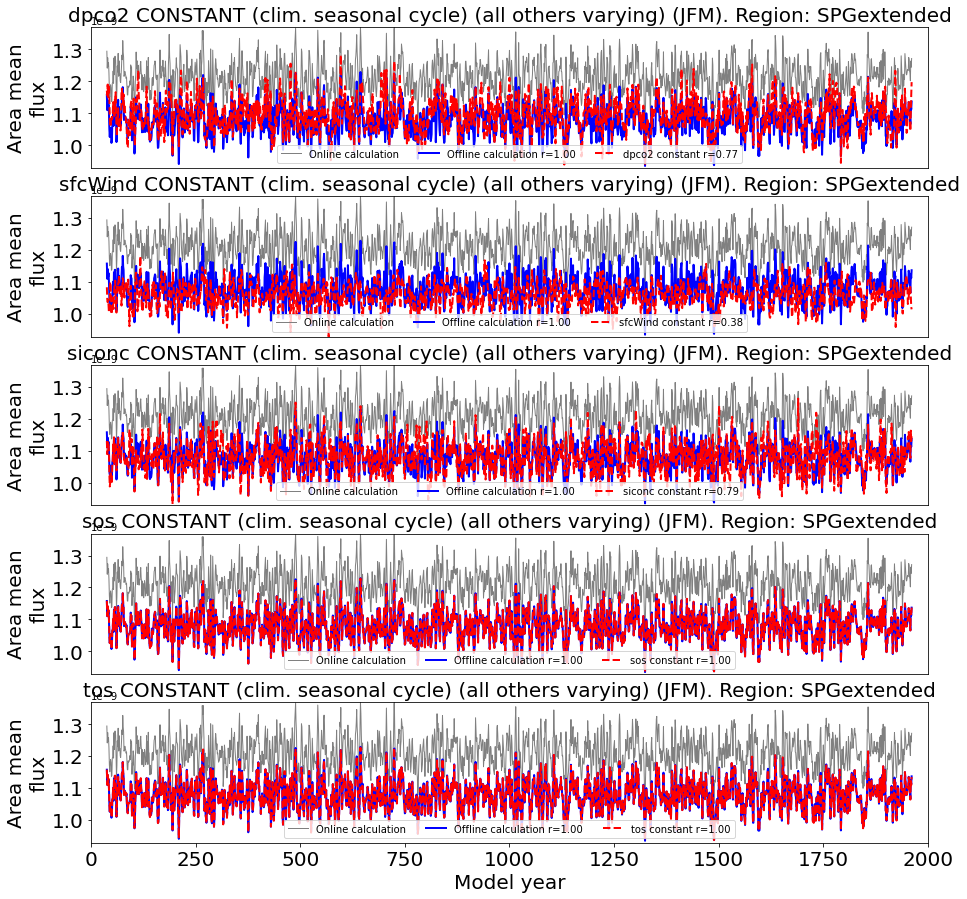

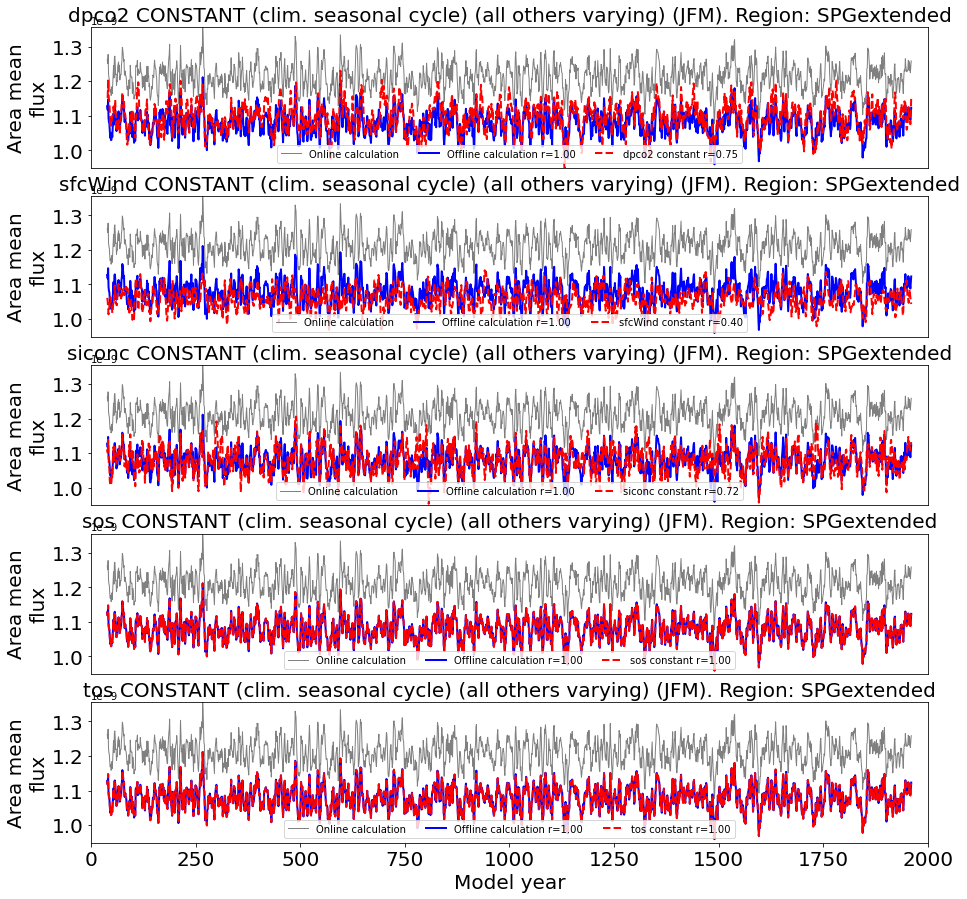

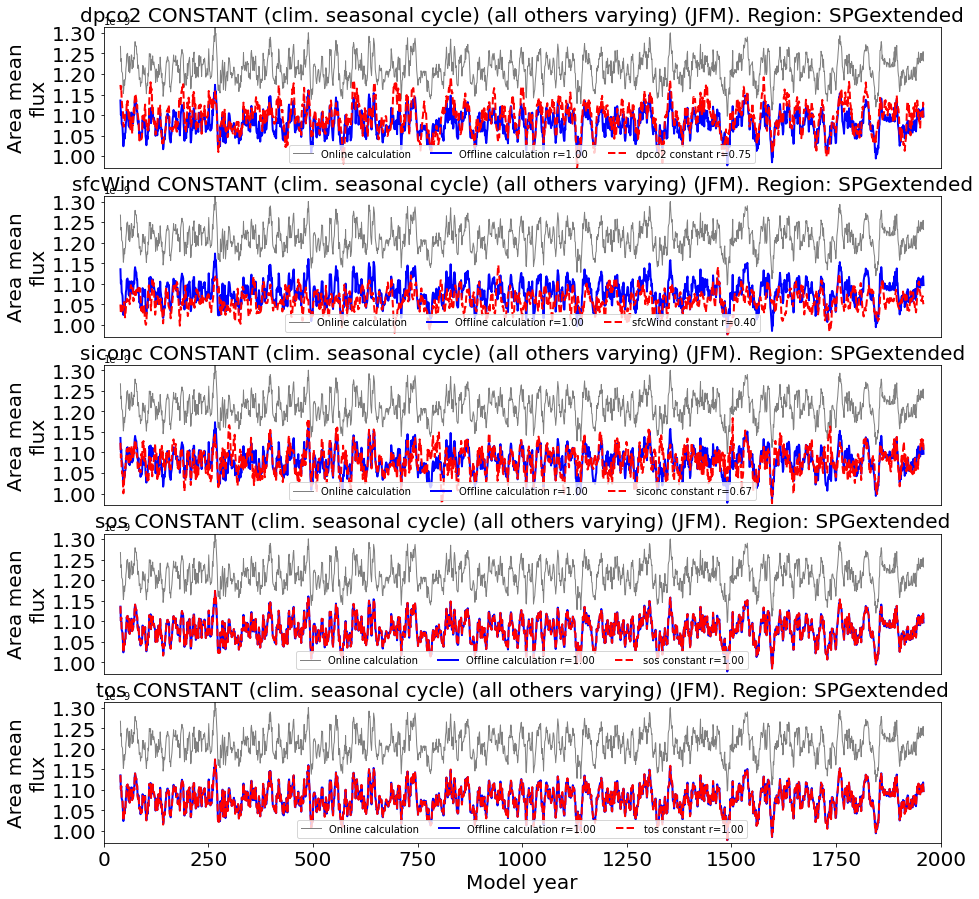

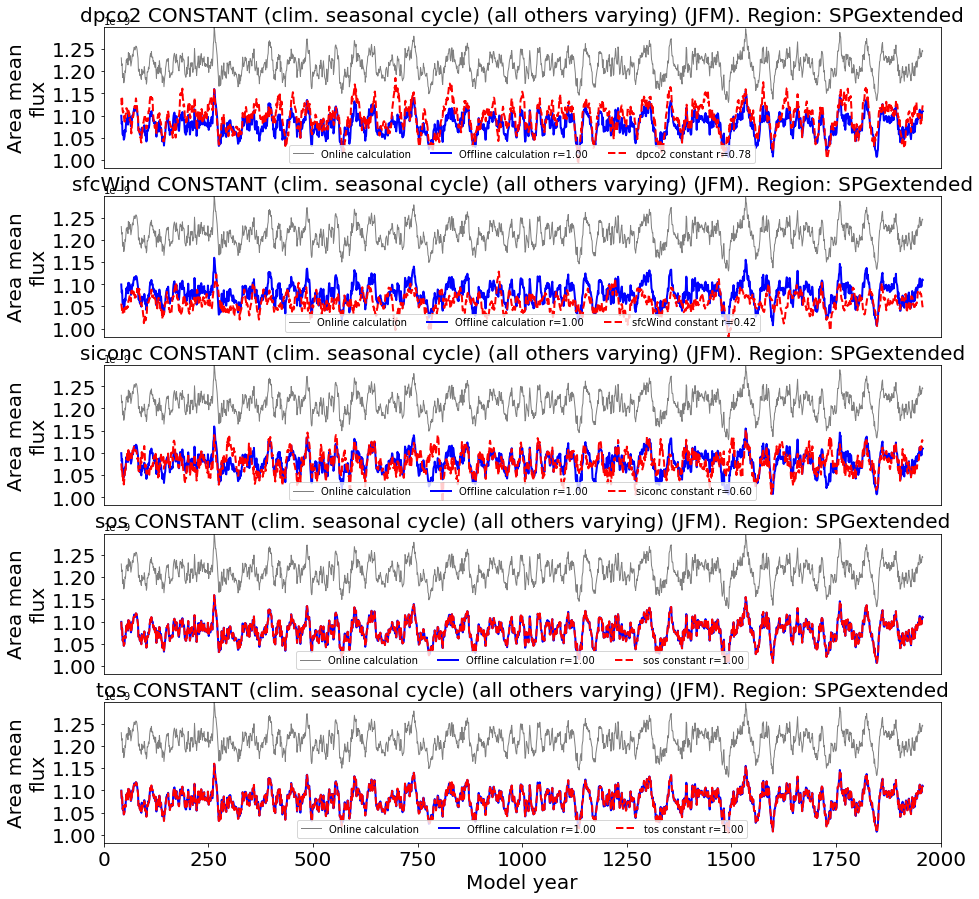

...

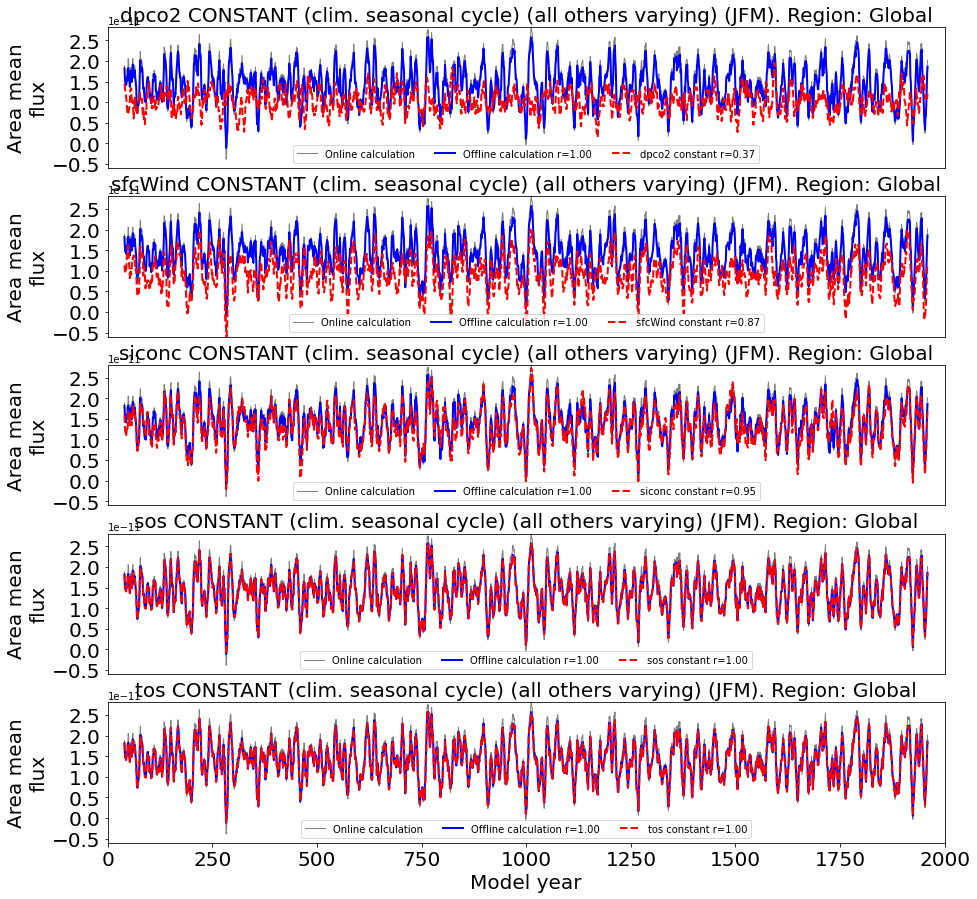

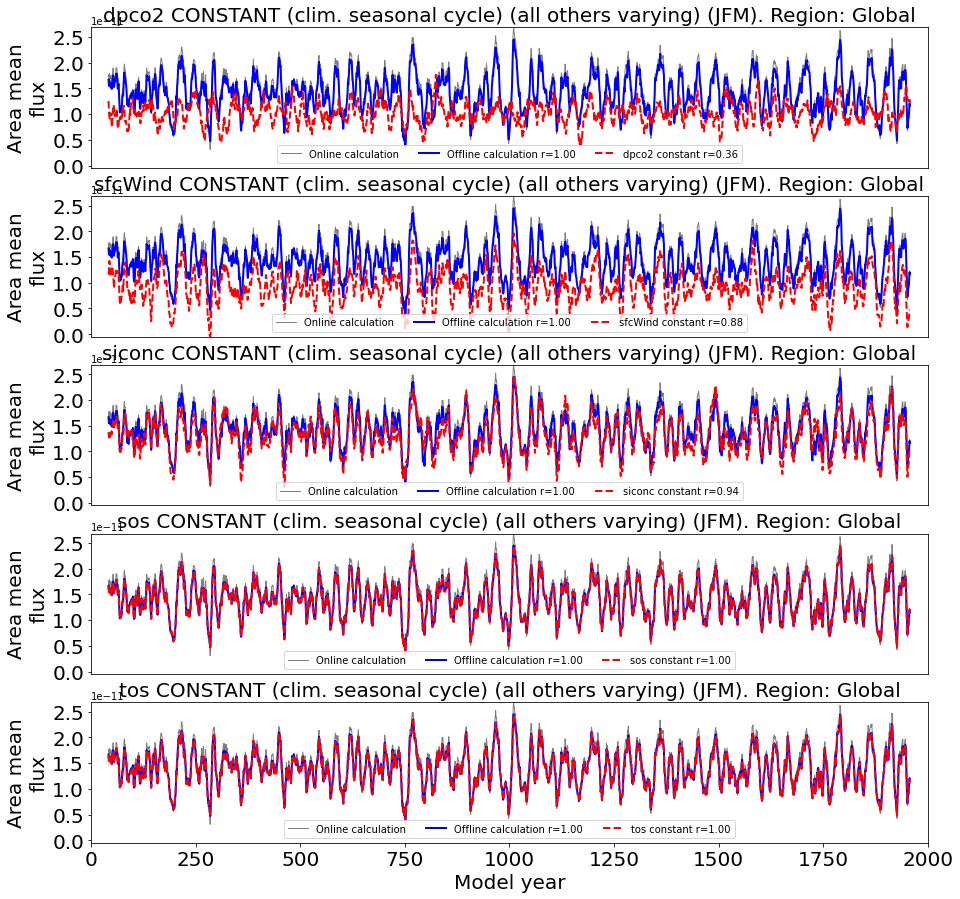

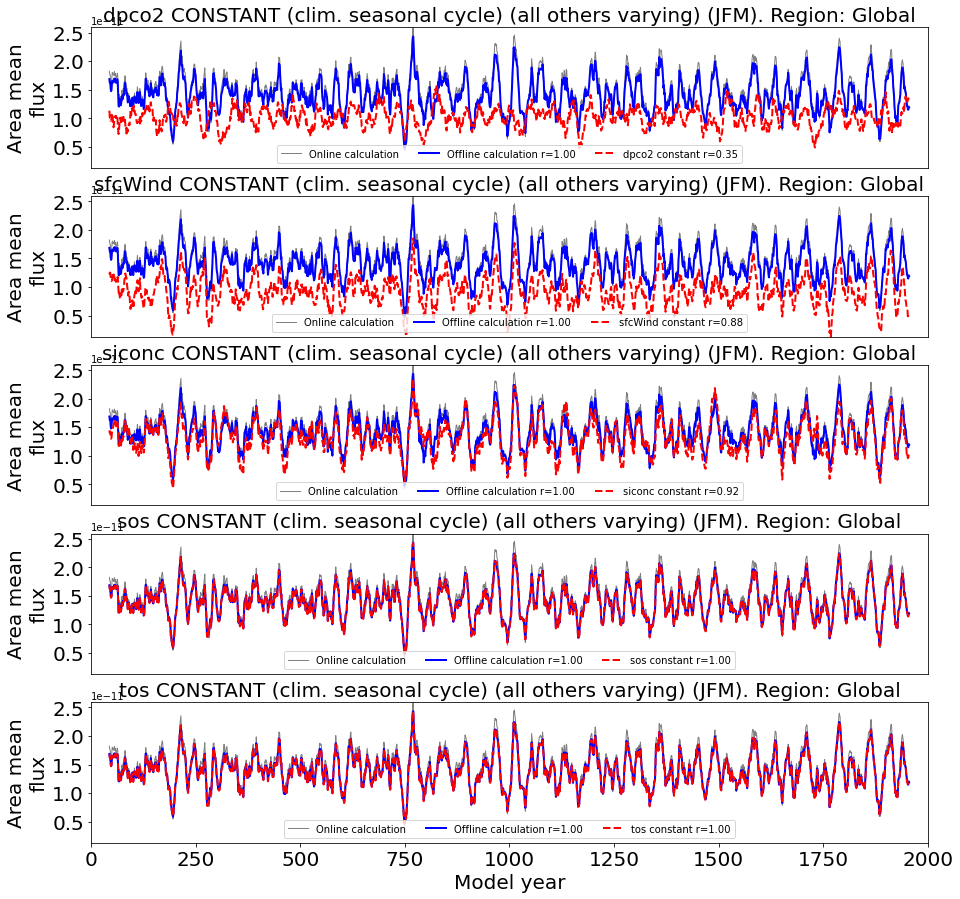

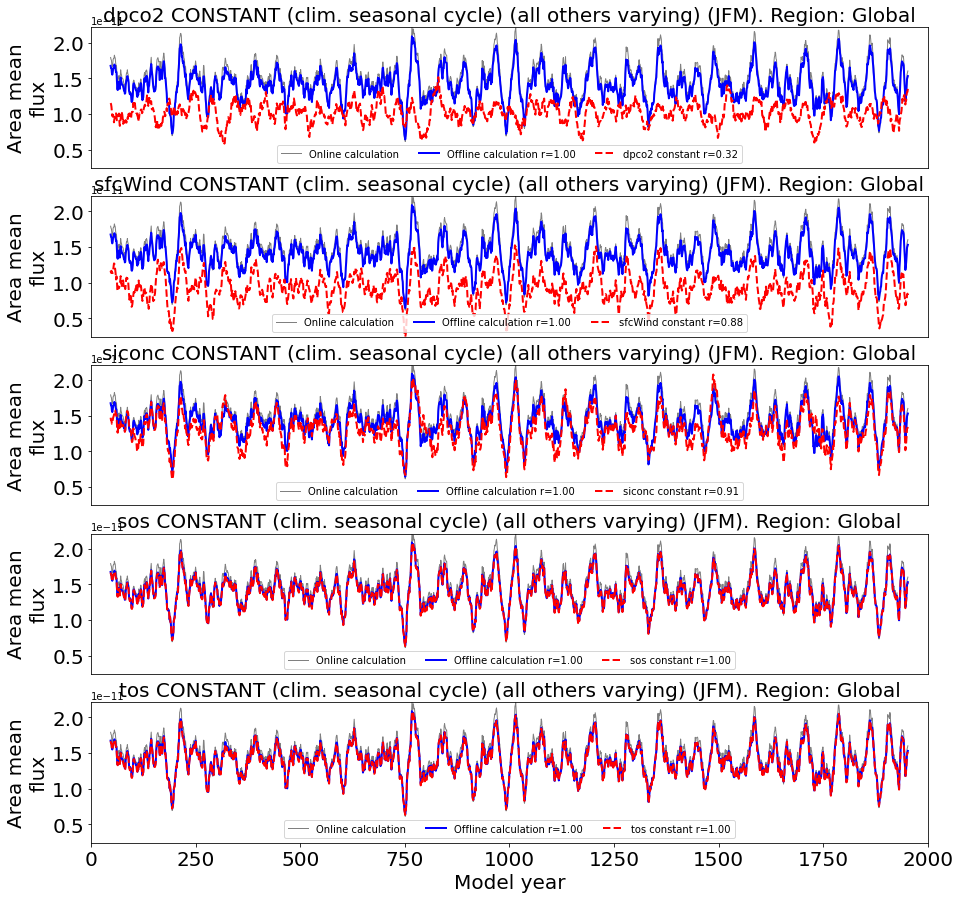

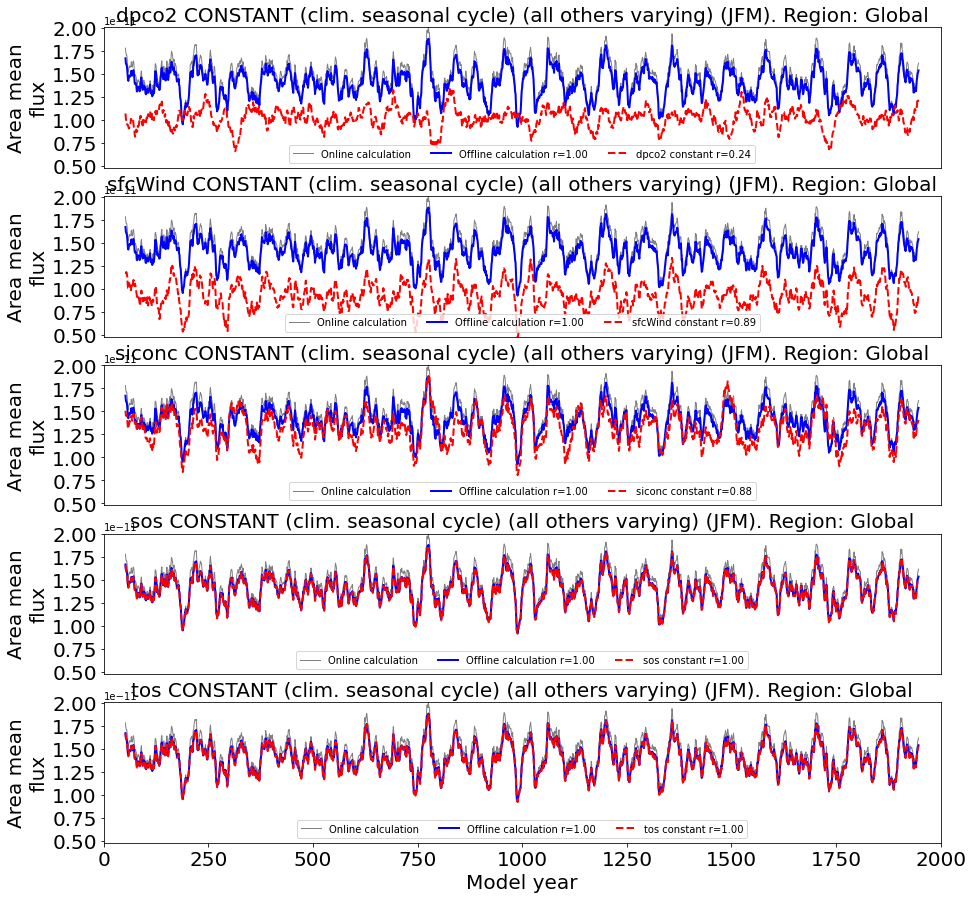

In [29]:
# ============================
# Time series where one var is constant
# ============================
fontsize = 20
# ylim = [np.array((4, 7)) / 1e10, np.array((-7, -3)) / 1e10, np.array((-4, 0)) / 1e10, np.array((0, 0.8)) / 1e10]
xlim = (0, 2000)
lw1 = 1
lw2 = 2

smoothings = [1, 3, 5, 7, 11, 15, 21, 31, 41, 51, 71]

for iregion, region in enumerate(regions):
    for ismooth, smoothing in enumerate(smoothings):
        if smoothing > 31: continue
        fig = plt.figure(figsize=(15, 15))
        fig.patch.set_facecolor('white')
        
        ylim = get_min_max(region, smoothing, constantOrVary='constant')
            
        for ivar, var in enumerate(constant_vars):
            if var == 'none': continue
            plt.subplot(5, 1, ivar)

            timeSeries = timeSeries_oneConstant[region][var]
            timeSeries_offline = timeSeries_oneConstant[region]['none']
            timeSeries_online2 = timeSeries_online[region]

            if detrend:
                detrend_string = '_Detrended71Y'
                timeSeries = detrend_ts(timeSeries)
                timeSeries_offline = detrend_ts(timeSeries_offline)
                timeSeries_online2 = detrend_ts(timeSeries_online2)
            else:
                detrend_string = ''
                
            if smoothing > 1:
                timeSeries = mfilter.smooth1d(timeSeries, smoothing, mask_ends=True)
                timeSeries_offline = mfilter.smooth1d(timeSeries_offline, smoothing, mask_ends=True)
                timeSeries_online2 = mfilter.smooth1d(timeSeries_online2, smoothing, mask_ends=True)

            real = np.nonzero(timeSeries * timeSeries_offline * timeSeries_online2)
            corr_constant = np.corrcoef(timeSeries[real], timeSeries_offline[real])[0][1]
            corr_full = np.corrcoef(timeSeries_offline[real], timeSeries_online2[real])[0][1]

            plt.plot(timeSeries_online2, color='grey', label='Online calculation', lw=lw1)
            plt.plot(timeSeries_offline, color='blue', label='Offline calculation r={:.2f}'.format(corr_full), lw=lw2)
            plt.plot(timeSeries, color='red', label='{:s} constant r={:.2f}'.format(var, corr_constant), lw=lw2, linestyle='--')
            plt.legend(ncol=3, loc=8)

            plt.title('{:s} CONSTANT (clim. seasonal cycle) (all others varying) {:s}. Region: {:s}'.format(var, season_string2, region), fontsize=fontsize)
            plt.ylim(ylim)

            plt.ylabel('Area mean\nflux', fontsize=fontsize)
            plt.yticks(fontsize=fontsize)
            plt.xlim(xlim)
            if ivar == 5:
                plt.xlabel('Model year', fontsize=fontsize)
                plt.xticks(fontsize=fontsize)
            else:
                plt.xticks([])

        fig_save_file = '{:s}/CO2_Offline_TimeSeries_{:s}_OneConstant_Smoothing{:d}Y{:s}{:s}.png'
        fig_save_file = fig_save_file.format(output_dir, region, smoothing, detrend_string, season_string)
        plt.savefig(fig_save_file, bbox_inches = 'tight')
        print(fig_save_file)

/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Smoothing1Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Smoothing3Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Smoothing5Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Smoothing7Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Smoothing11Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Smoothing15Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Smoothing21Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SPGextended_OneVaries_Sm

/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2559: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2560: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing1Y_Detrended71Y_Season1.png


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2559: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2560: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing3Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing5Y_Detrended71Y_Season1.png


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2559: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2560: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing7Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing11Y_Detrended71Y_Season1.png


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2559: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2560: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing15Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing21Y_Detrended71Y_Season1.png


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2559: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2560: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_EQPac_OneVaries_Smoothing31Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing1Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing3Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing5Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing7Y_Detrended71Y_Season1.png


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing11Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing15Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing21Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_SO_OneVaries_Smoothing31Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneVaries_Smoothing1Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneVaries_Smoothing3Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneVaries_Smoothing5Y_Detrended71Y_Season1.png
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_TimeSeries_Global_OneVaries_Smoothing7Y_Detrended71Y_Season1.png
/home/mmenary/python

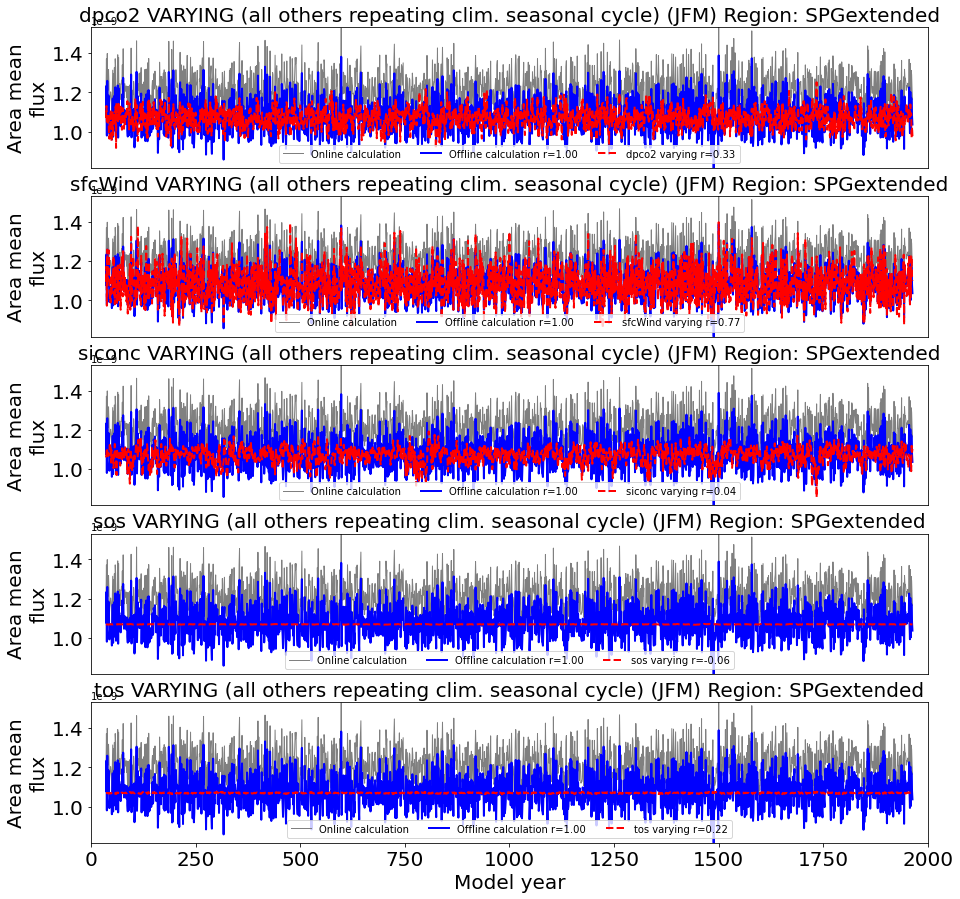

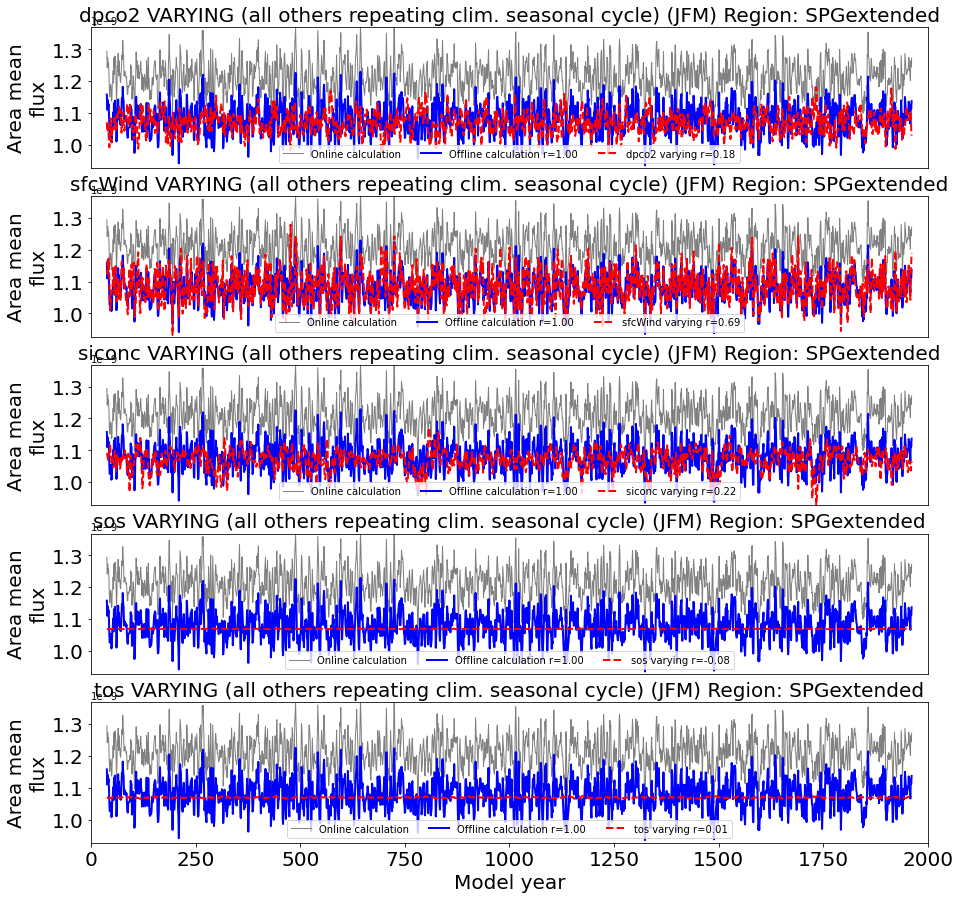

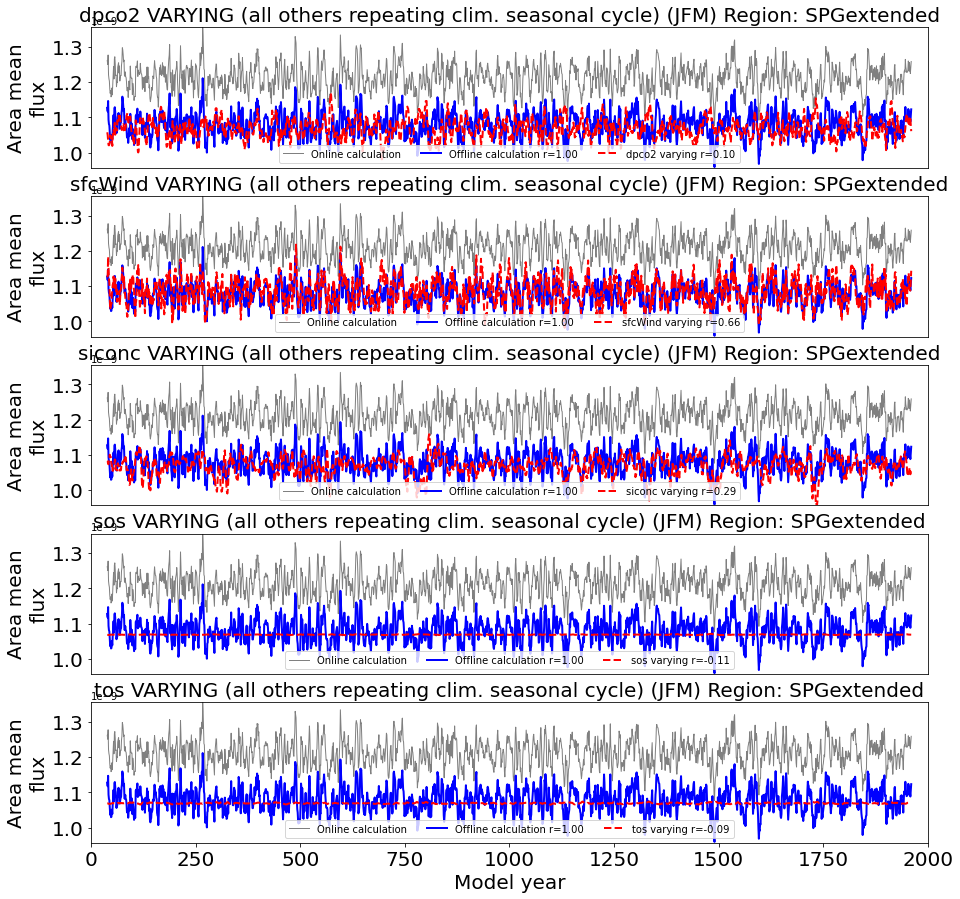

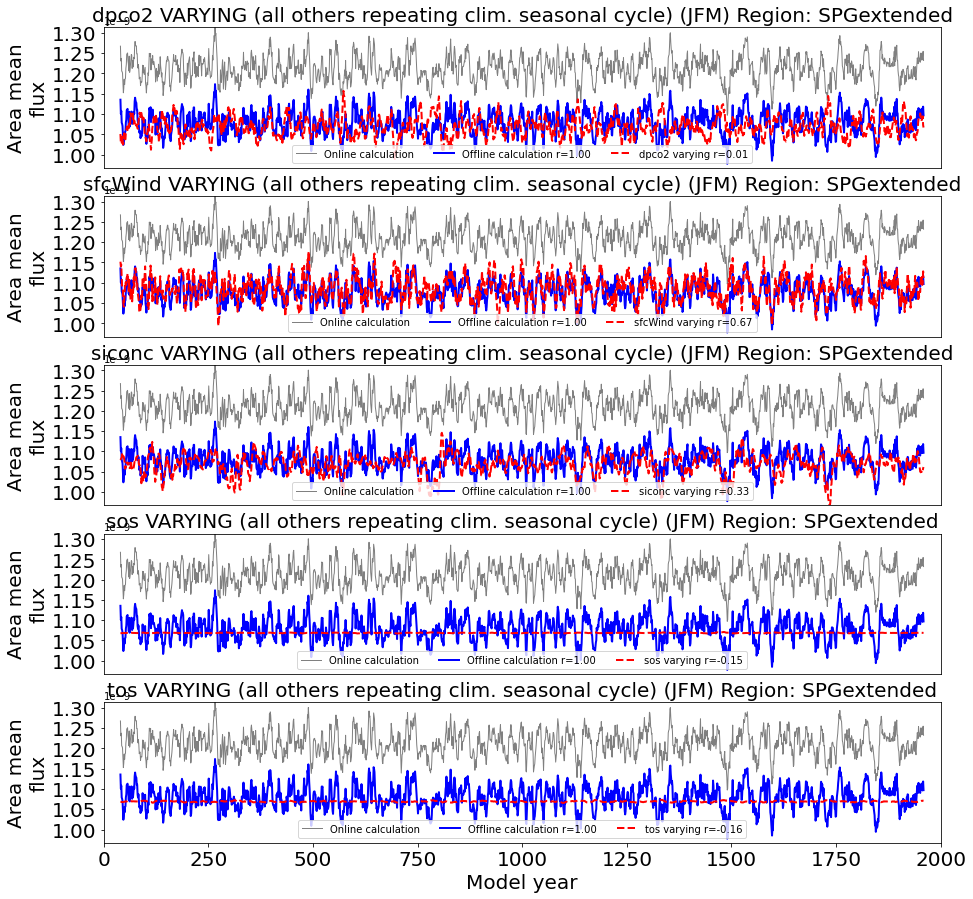

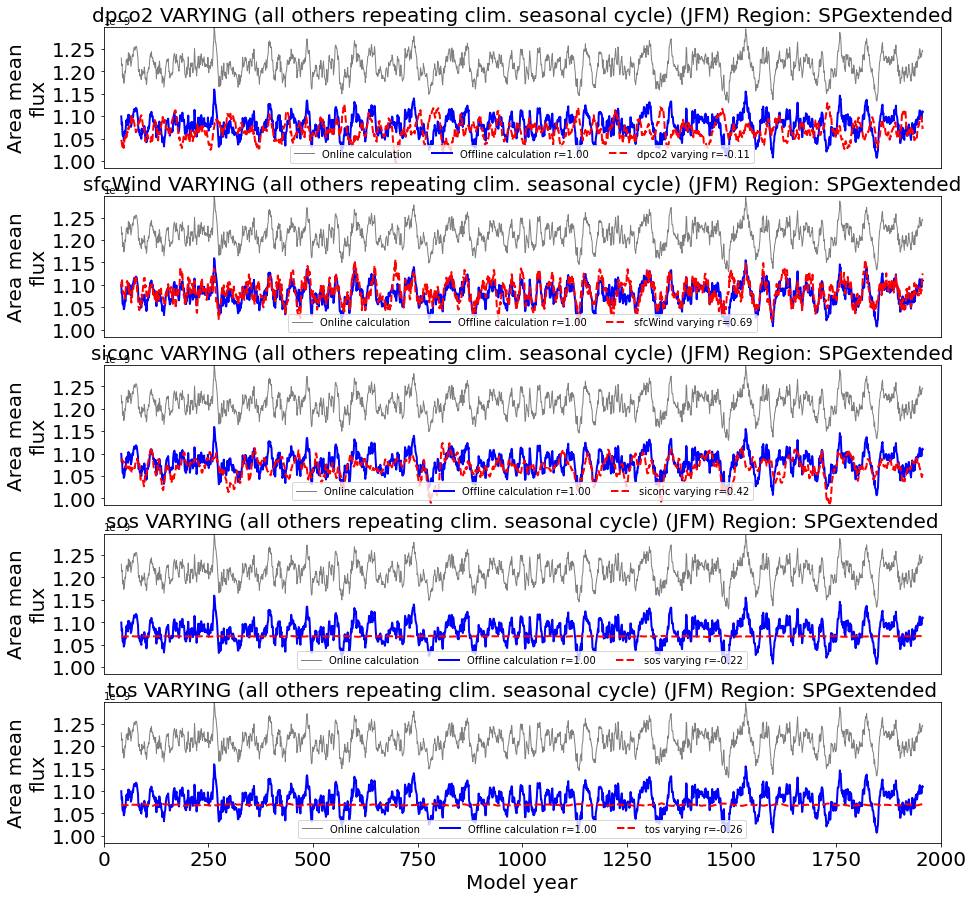

...

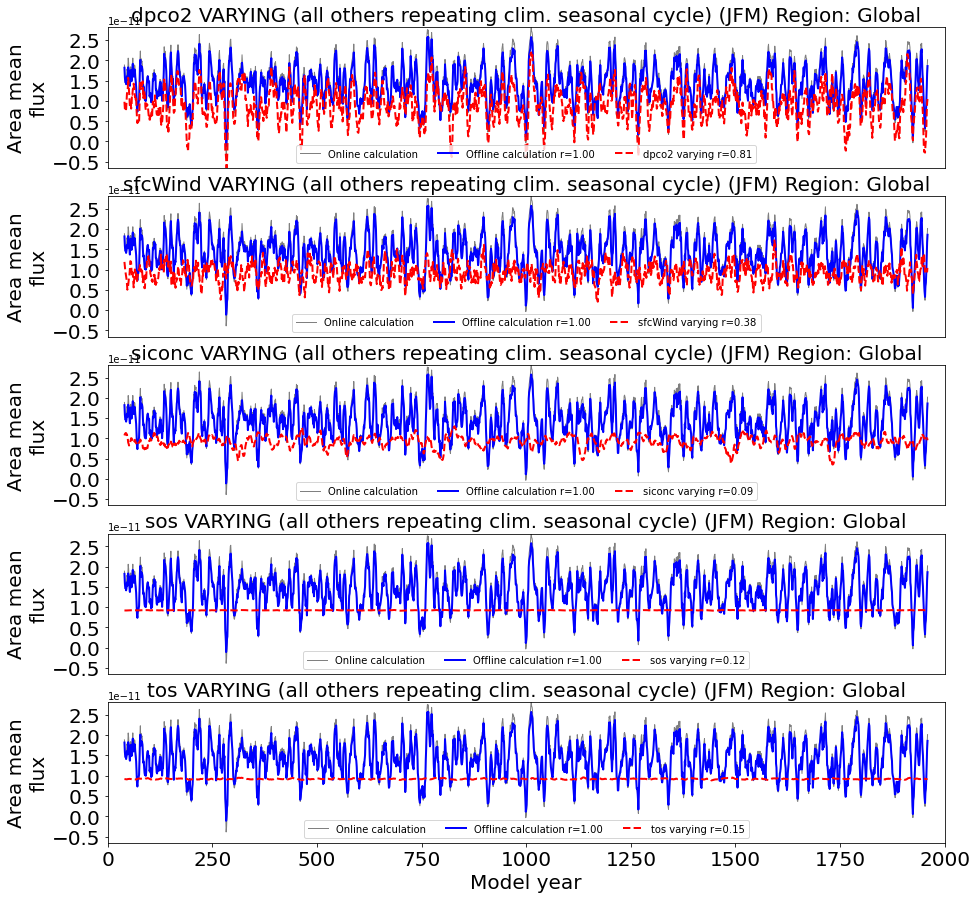

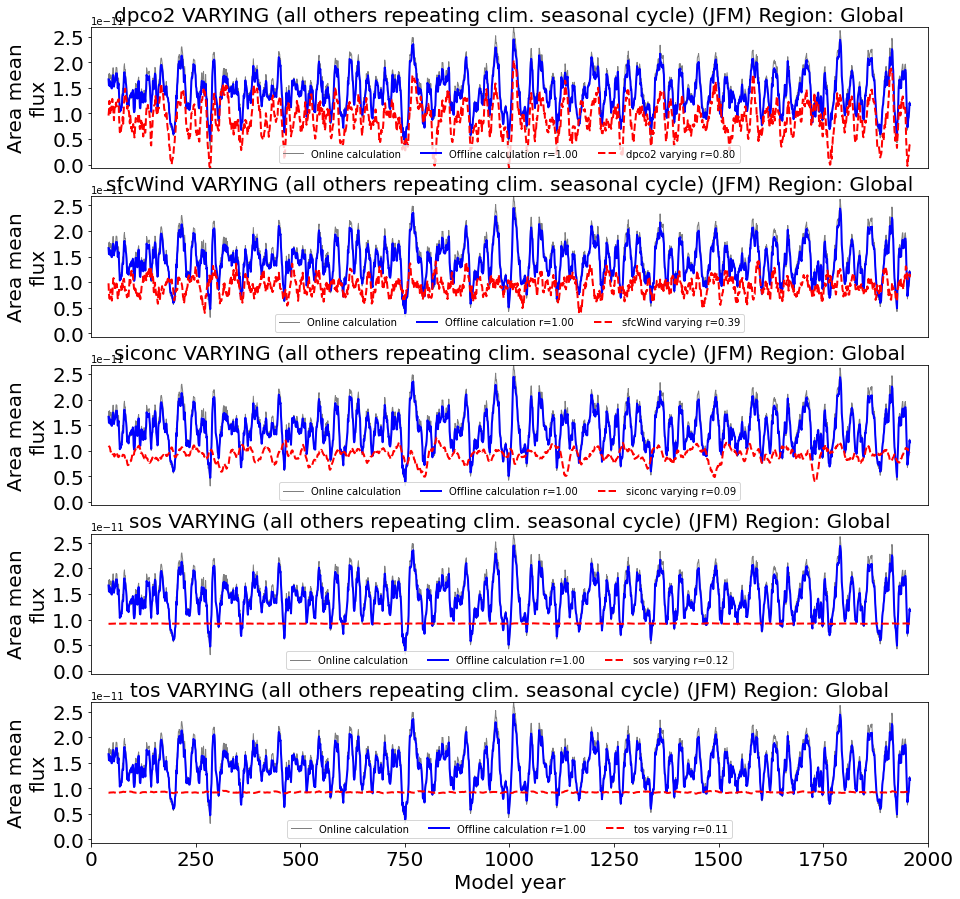

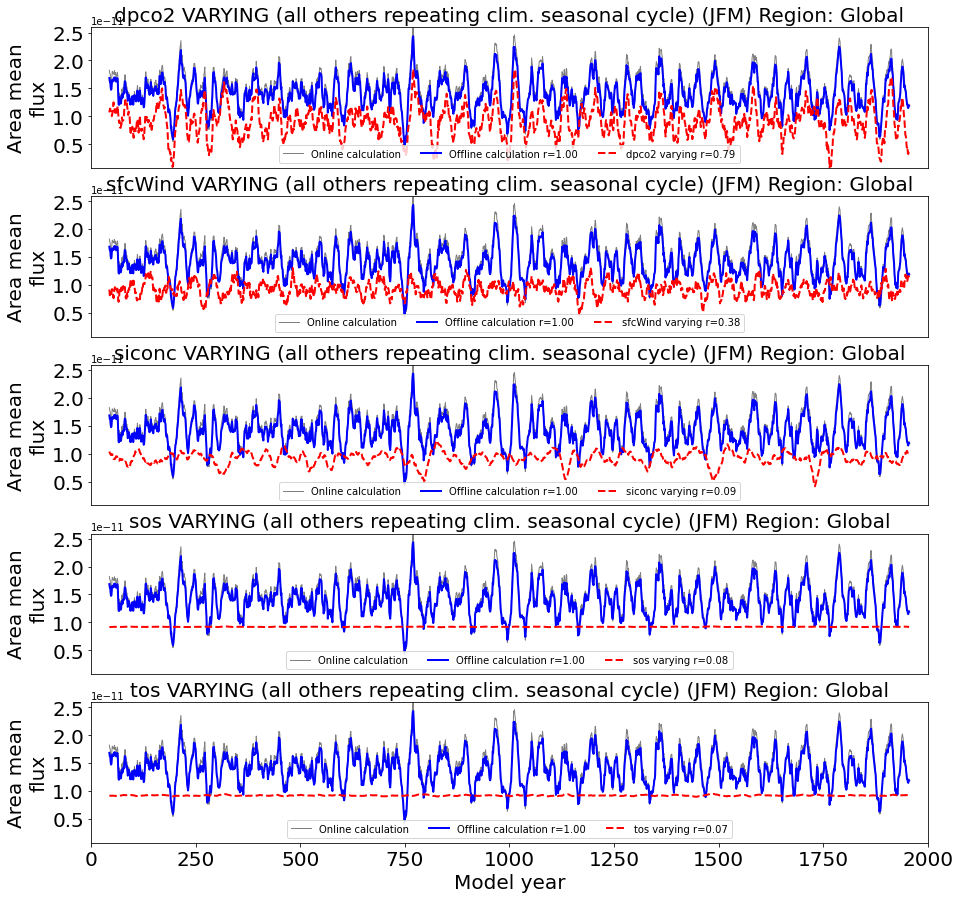

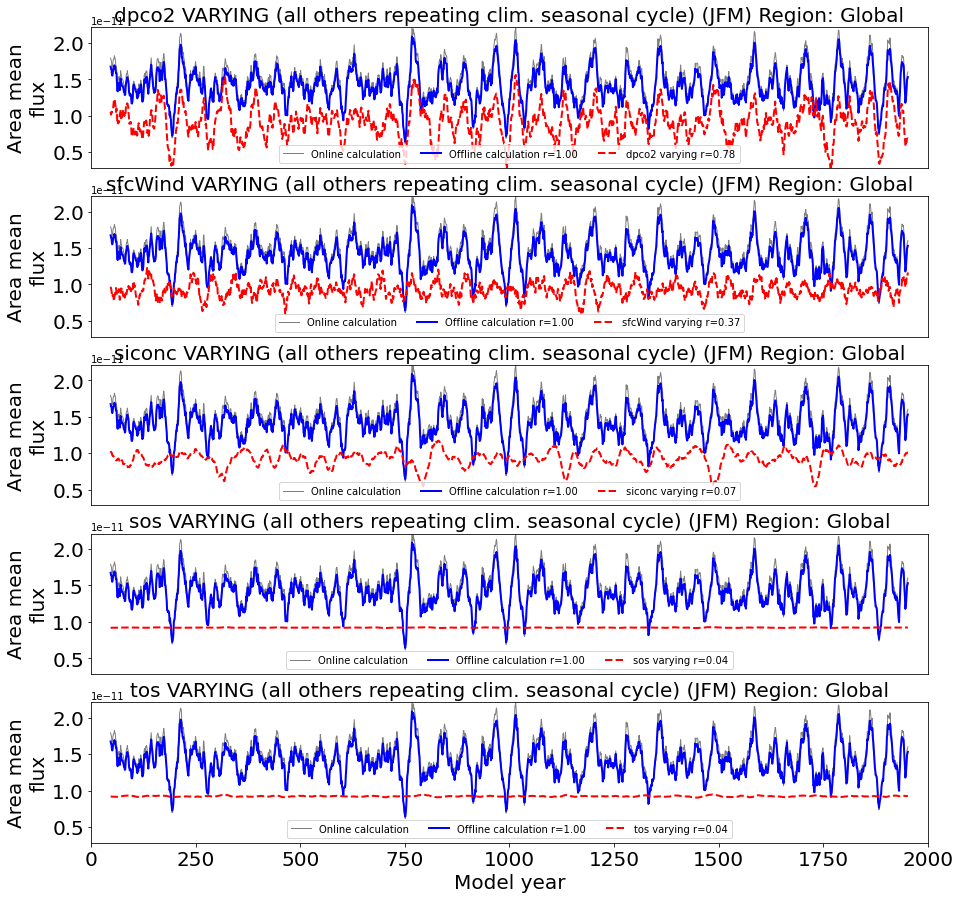

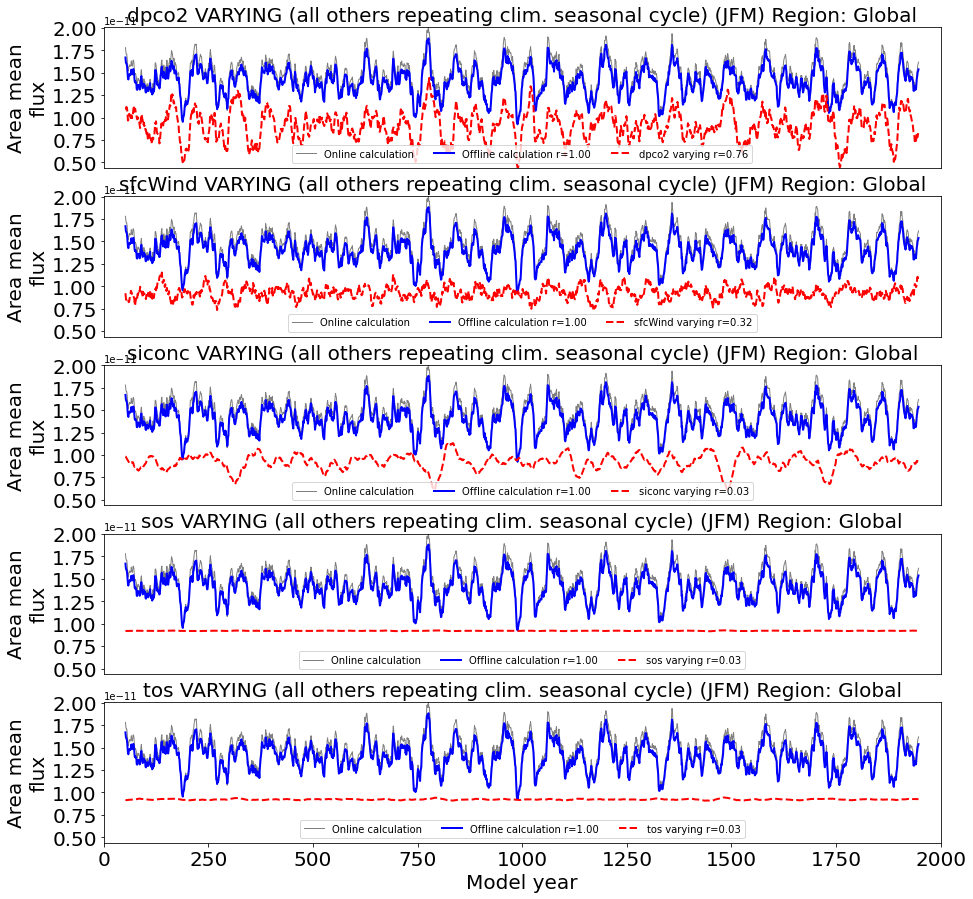

In [30]:
# ============================
# Time series where one var is varying
# Note: timeSeries_oneConstant['none'] is used for the full offline calculation
# ============================
for iregion, region in enumerate(regions):
    for ismooth, smoothing in enumerate(smoothings):
        if smoothing > 31: continue
        fig = plt.figure(figsize=(15, 15))
        fig.patch.set_facecolor('white')
        
        ylim = get_min_max(region, smoothing, constantOrVary='vary')
        
        for ivar, var in enumerate(constant_vars):
            if var == 'none': continue
            plt.subplot(5, 1, ivar)

            timeSeries = timeSeries_oneVary[region][var]
            timeSeries_offline = timeSeries_oneConstant[region]['none']
            timeSeries_online2 = timeSeries_online[region]

            if detrend:
                detrend_string = '_Detrended71Y'
                timeSeries = detrend_ts(timeSeries)
                timeSeries_offline = detrend_ts(timeSeries_offline)
                timeSeries_online2 = detrend_ts(timeSeries_online2)
            else:
                detrend_string = ''
                
            if smoothing > 1:
                timeSeries = mfilter.smooth1d(timeSeries, smoothing, mask_ends=True)
                timeSeries_offline = mfilter.smooth1d(timeSeries_offline, smoothing, mask_ends=True)
                timeSeries_online2 = mfilter.smooth1d(timeSeries_online2, smoothing, mask_ends=True)

            real = np.nonzero(timeSeries * timeSeries_offline * timeSeries_online2)
            corr_constant = np.corrcoef(timeSeries[real], timeSeries_offline[real])[0][1]
            corr_full = np.corrcoef(timeSeries_offline[real], timeSeries_online2[real])[0][1]

            plt.plot(timeSeries_online2, color='grey', label='Online calculation', lw=lw1)
            plt.plot(timeSeries_offline, color='blue', label='Offline calculation r={:.2f}'.format(corr_full), lw=lw2)
            plt.plot(timeSeries, color='red', label='{:s} varying r={:.2f}'.format(var, corr_constant), lw=lw2, linestyle='--')
            plt.legend(ncol=3, loc=8)

            plt.title('{:s} VARYING (all others repeating clim. seasonal cycle) {:s} Region: {:s}'.format(var, season_string2, region), fontsize=fontsize)
            plt.ylim(ylim)

            plt.ylabel('Area mean\nflux', fontsize=fontsize)
            plt.yticks(fontsize=fontsize)
            plt.xlim(xlim)
            if ivar == 5:
                plt.xlabel('Model year', fontsize=fontsize)
                plt.xticks(fontsize=fontsize)
            else:
                plt.xticks([])

        fig_save_file = '{:s}/CO2_Offline_TimeSeries_{:s}_OneVaries_Smoothing{:d}Y{:s}{:s}.png'
        fig_save_file = fig_save_file.format(output_dir, region, smoothing, detrend_string, season_string)
        plt.savefig(fig_save_file, bbox_inches = 'tight')
        print(fig_save_file)

In [31]:
## Set EQ Pac to zero instead of masked data
timeSeries_oneVary['EQPac']['siconc'][:] = 0
print(timeSeries_oneVary['EQPac']['siconc'][:])

[0.0 0.0 0.0 ... 0.0 0.0 0.0]


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2551: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_AreaMeanCorrs_oneConstant_Smoothing_Detrended71Y_Season1.png


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2551: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_AreaMeanCorrs_oneVaries_Smoothing_Detrended71Y_Season1.png


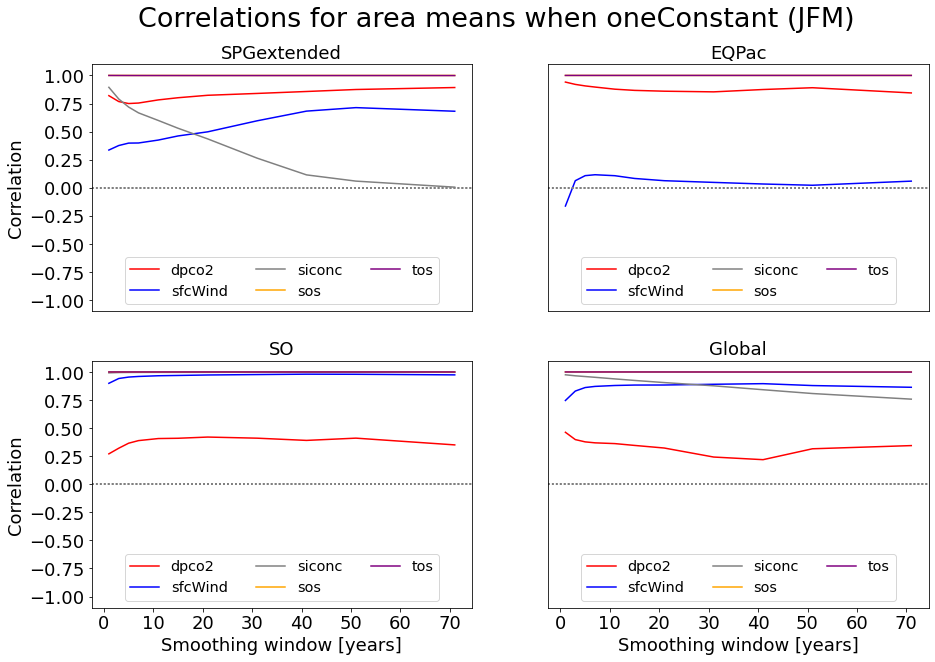

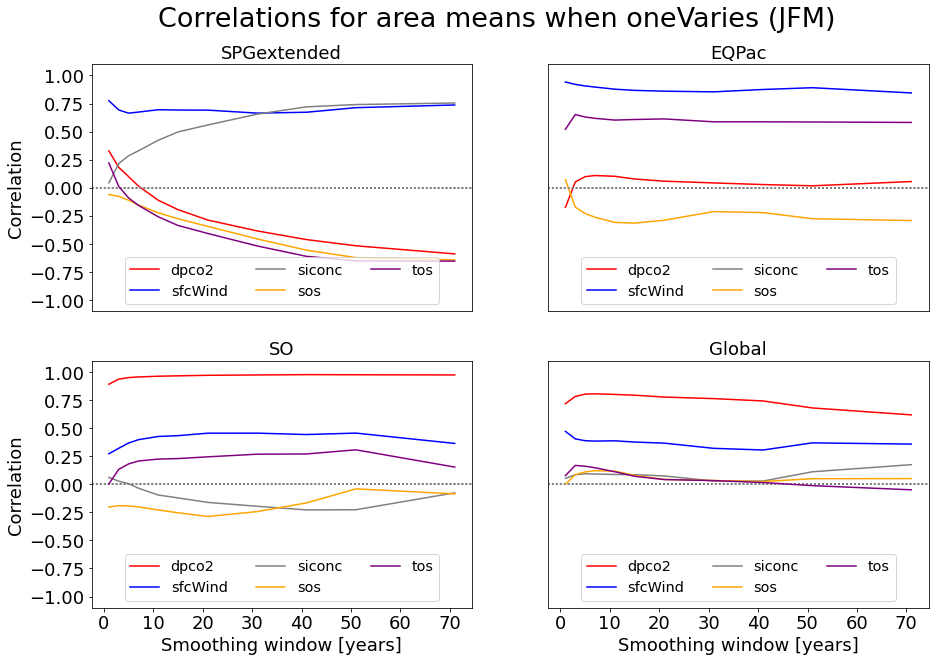

In [32]:
detrend = True
color = ['', 'red', 'blue', 'grey', 'orange', 'purple']
fontsize = 18

for plot_type in ['oneConstant', 'oneVaries']:
    fig = plt.figure(figsize=(15, 10))
    fig.patch.set_facecolor('white')
    for iregion, region in enumerate(regions):
        plt.subplot(2, 2, iregion+1)

        for ivar, var in enumerate(constant_vars):
            if var == 'none': continue
            timeSeries_constant = timeSeries_oneConstant[region][var]
            timeSeries_vary = timeSeries_oneVary[region][var]
            timeSeries_offline = timeSeries_oneConstant[region]['none']

            if detrend:
                detrend_string = '_Detrended71Y'
                timeSeries_constant = detrend_ts(timeSeries_constant)
                timeSeries_vary = detrend_ts(timeSeries_vary)
                timeSeries_offline = detrend_ts(timeSeries_offline)
            else:
                detrend_string = ''

            corr_constant = np.ma.masked_all(shape=(len(smoothings)))
            corr_vary = np.ma.masked_all(shape=(len(smoothings)))
            for ismooth, smoothing in enumerate(smoothings):
                if smoothing > 1:
                    timeSeries_constant2 = mfilter.smooth1d(timeSeries_constant, smoothing, mask_ends=True)
                    timeSeries_vary2 = mfilter.smooth1d(timeSeries_vary, smoothing, mask_ends=True)
                    timeSeries_offline2 = mfilter.smooth1d(timeSeries_offline, smoothing, mask_ends=True)
                else:
                    timeSeries_constant2 = timeSeries_constant
                    timeSeries_vary2 = timeSeries_vary
                    timeSeries_offline2 = timeSeries_offline

                real = np.nonzero(timeSeries_vary2 * timeSeries_offline2 * timeSeries_constant2)
                corr_constant[ismooth] = np.corrcoef(timeSeries_constant2[real], timeSeries_offline2[real])[0][1]
                corr_vary[ismooth] = np.corrcoef(timeSeries_vary2[real], timeSeries_offline2[real])[0][1]

            plt.axhline(0, color='grey', linestyle=':')
            if plot_type == 'oneConstant':
                plt.plot(smoothings, corr_constant, color=color[ivar], label=var)
            else:
                plt.plot(smoothings, corr_vary, color=color[ivar], label=var)
                
        plt.title(region, fontsize=fontsize)
        plt.ylim(-1.1, 1.1)
        plt.legend(ncol=3, loc=8, fontsize=fontsize*0.8)

        if iregion >= 2:
            plt.xlabel('Smoothing window [years]', fontsize=fontsize)
            plt.xticks(fontsize=fontsize)
        else:
            plt.xticks([])
        if (iregion % 2) == 0:
            plt.ylabel('Correlation', fontsize=fontsize)
            plt.yticks(fontsize=fontsize)
        else:
            plt.yticks([])

    plt.suptitle('Correlations for area means when {:s} {:s}'.format(plot_type, season_string2), y=0.96, fontsize=fontsize*1.5)
    fig_save_file = '{:s}/CO2_Offline_AreaMeanCorrs_{:s}_Smoothing{:s}{:s}.png'
    fig_save_file = fig_save_file.format(output_dir, plot_type, detrend_string, season_string)
    plt.savefig(fig_save_file, bbox_inches = 'tight')
    print(fig_save_file)

/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2551: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_AreaMeanVarExplained_oneConstant_Smoothing_Detrended71Y_Season1.png
SPGextended [ 76.24666305  56.45203802  55.27071679  61.12430691  79.04925234
  95.325767   115.5651262  149.39698587 186.56244763 213.44587555
 229.84274429]


/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2551: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


EQPac [119.22353049 130.40533668 128.0829716  126.62257266 123.84519143
 122.59946205 120.15591484 112.05895044 115.96648829 121.23675211
 113.90055528]
SO [ 91.16000403 103.36512918 110.71724872 115.51829085 121.8291865
 125.06196603 131.59279105 132.29476392 130.10217858 130.50204092
 111.58595332]
Global [74.53504683 81.69079585 84.09956571 84.04828191 82.29204029 78.85769837
 74.5447472  68.68025574 64.49090208 61.21344    54.51022175]
/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_AreaMeanVarExplained_oneVaries_Smoothing_Detrended71Y_Season1.png


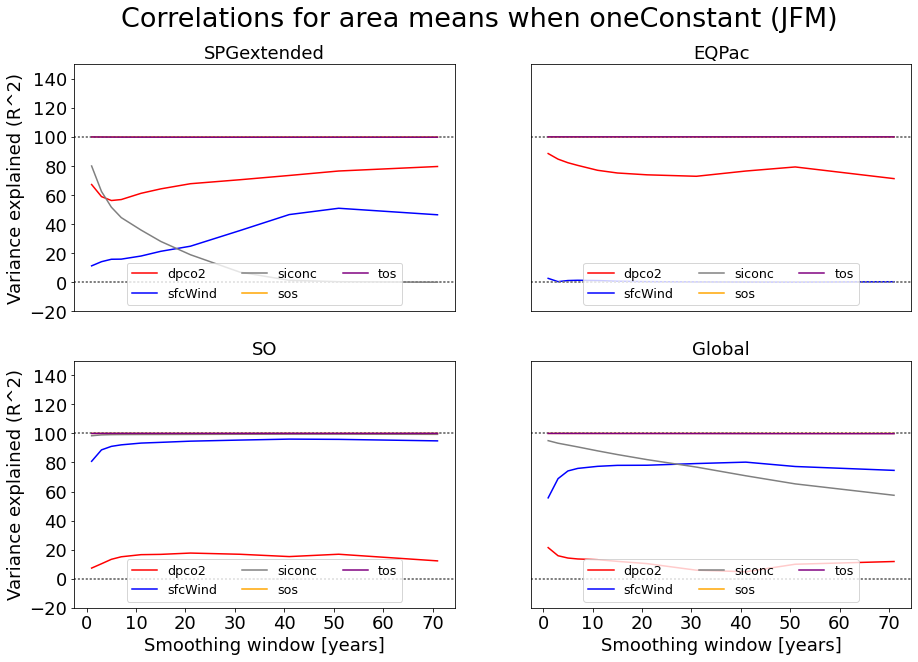

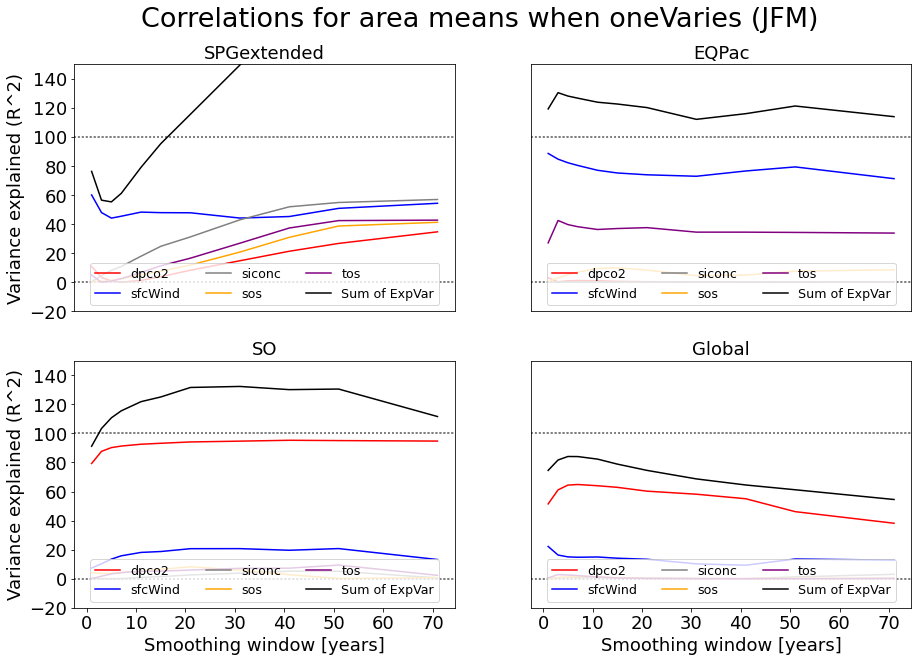

In [39]:
detrend = True

for plot_type in ['oneConstant', 'oneVaries']:
    fig = plt.figure(figsize=(15, 10))
    fig.patch.set_facecolor('white')
    for iregion, region in enumerate(regions):
        plt.subplot(2, 2, iregion+1)

        corr_vary_sum = np.zeros(shape=(len(smoothings)))
        for ivar, var in enumerate(constant_vars):
            if var == 'none': continue
            timeSeries_constant = timeSeries_oneConstant[region][var]
            timeSeries_vary = timeSeries_oneVary[region][var]
            timeSeries_offline = timeSeries_oneConstant[region]['none']

            if detrend:
                detrend_string = '_Detrended71Y'
                timeSeries_constant = detrend_ts(timeSeries_constant)
                timeSeries_vary = detrend_ts(timeSeries_vary)
                timeSeries_offline = detrend_ts(timeSeries_offline)
            else:
                detrend_string = ''

            corr_constant = np.ma.masked_all(shape=(len(smoothings)))
            corr_vary = np.ma.masked_all(shape=(len(smoothings)))
            for ismooth, smoothing in enumerate(smoothings):
                if smoothing > 1:
                    timeSeries_constant2 = mfilter.smooth1d(timeSeries_constant, smoothing, mask_ends=True)
                    timeSeries_vary2 = mfilter.smooth1d(timeSeries_vary, smoothing, mask_ends=True)
                    timeSeries_offline2 = mfilter.smooth1d(timeSeries_offline, smoothing, mask_ends=True)
                else:
                    timeSeries_constant2 = timeSeries_constant
                    timeSeries_vary2 = timeSeries_vary
                    timeSeries_offline2 = timeSeries_offline

                real = np.nonzero(timeSeries_vary2 * timeSeries_offline2 * timeSeries_constant2)
                corr_constant[ismooth] = np.corrcoef(timeSeries_constant2[real], timeSeries_offline2[real])[0][1]
                corr_vary[ismooth] = np.corrcoef(timeSeries_vary2[real], timeSeries_offline2[real])[0][1]
                
            if (region == 'EQPac') and (var == 'siconc'):
                corr_vary[:] = 0.

            plt.axhline(0, color='grey', linestyle=':')
            plt.axhline(100, color='grey', linestyle=':')
            if plot_type == 'oneConstant':
                plt.plot(smoothings, corr_constant*corr_constant*100, color=color[ivar], label=var)
            else:
                plt.plot(smoothings, corr_vary*corr_vary*100, color=color[ivar], label=var)
                corr_vary_sum += corr_vary*corr_vary*100
                
        if plot_type == 'oneVaries':
            plt.plot(smoothings, corr_vary_sum, color='k', label='Sum of ExpVar')
            print(region, corr_vary_sum)
        plt.title(region, fontsize=fontsize)
        plt.legend(ncol=3, loc=8, fontsize=fontsize*0.7)
        plt.ylim(-20, 150)
        if iregion >= 2:
            plt.xlabel('Smoothing window [years]', fontsize=fontsize)
            plt.xticks(fontsize=fontsize)
        else:
            plt.xticks([])
        if (iregion % 2) == 0:
            plt.ylabel('Variance explained (R^2)', fontsize=fontsize)
            plt.yticks(fontsize=fontsize)
        else:
            plt.yticks([])

    plt.suptitle('Correlations for area means when {:s} {:s}'.format(plot_type, season_string2), y=0.96, fontsize=fontsize*1.5)
    fig_save_file = '{:s}/CO2_Offline_AreaMeanVarExplained_{:s}_Smoothing{:s}{:s}.png'
    fig_save_file = fig_save_file.format(output_dir, plot_type, detrend_string, season_string)
    plt.savefig(fig_save_file, bbox_inches = 'tight')
    print(fig_save_file)

/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2551: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/home/mmenary/anaconda2/envs/py3x/lib/python3.7/site-packages/numpy/lib/function_base.py:2480: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


/home/mmenary/python/notebooks/CO2_Py3x/output/CO2_Offline_AreaMeanVarExplainedFraction_oneVaries_Smoothing_Detrended71Y_Season1.png


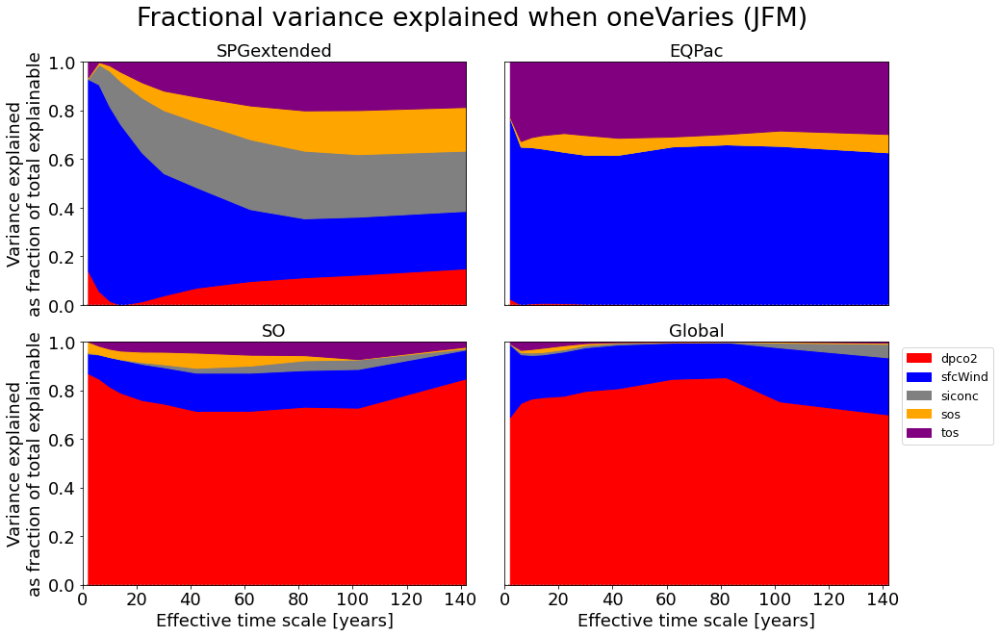

In [40]:
import matplotlib.gridspec as gridspec

smoothings = np.array(smoothings)

block_method = True

corr_vary = np.ma.masked_all(shape=(len(regions), len(constant_vars), len(smoothings)))
for iregion, region in enumerate(regions):
    for ivar, var in enumerate(constant_vars):
        if var == 'none': continue
        for ismooth, smoothing in enumerate(smoothings):
            timeSeries_vary = timeSeries_oneVary[region][var]
            timeSeries_offline = timeSeries_oneConstant[region]['none']

            if detrend:
                detrend_string = '_Detrended71Y'
                timeSeries_vary = detrend_ts(timeSeries_vary)
                timeSeries_offline = detrend_ts(timeSeries_offline)
            else:
                detrend_string = ''
                
            if smoothing > 1:
                timeSeries_vary = mfilter.smooth1d(timeSeries_vary, smoothing, mask_ends=True)
                timeSeries_offline = mfilter.smooth1d(timeSeries_offline, smoothing, mask_ends=True)

            real = np.nonzero(timeSeries_vary * timeSeries_offline)
            corr = np.corrcoef(timeSeries_vary[real], timeSeries_offline[real])[0][1]
            if (region == 'EQPac') and (var == 'siconc'):
                corr = 0.0
            corr_vary[iregion, ivar, ismooth] = corr * corr * 100
        
corr_vary_sum = np.repeat(corr_vary.sum(axis=1)[:, np.newaxis, :], len(constant_vars), axis=1)
corr_vary_frac = corr_vary / corr_vary_sum
    
gs1 = gridspec.GridSpec(2, 2)
gs1.update(wspace=0.10, hspace=0.15)
fig = plt.figure(figsize=(15, 10))
fig.patch.set_facecolor('white')
for iregion, region in enumerate(regions):
    ax = plt.subplot(gs1[iregion])
    plt.axhline(0, color='grey', linestyle=':')
    
    previous_total = np.zeros(shape=(len(smoothings)))
    for ivar, var in enumerate(constant_vars):
        if var == 'none': continue
            
        if block_method:
            new_total = previous_total + corr_vary_frac[iregion, ivar, :]
            plt.fill_between(smoothings*2, previous_total, y2=new_total, color=color[ivar], label=var)
            previous_total = new_total
        else:
            plt.plot(smoothings*2, corr_vary_frac[iregion, ivar, :], color=color[ivar], label=var)
            
    plt.title(region, fontsize=fontsize)
    plt.ylim(0, 1)
#     plt.xlim(smoothings[0], smoothings[-1])
    plt.xlim(0, smoothings[-1]*2)
    if iregion >= 2:
#         plt.xlabel('Smoothing window [years]', fontsize=fontsize)
        plt.xlabel('Effective time scale [years]', fontsize=fontsize)
        plt.xticks(fontsize=fontsize)
    else:
        plt.xticks([])
    if (iregion % 2) == 0:
        plt.ylabel('Variance explained\nas fraction of total explainable', fontsize=fontsize)
        plt.yticks(fontsize=fontsize)
    else:
        plt.yticks([])
    if iregion == 3:
        plt.legend(ncol=1, loc=2, bbox_to_anchor=(1.02, 1), fontsize=fontsize*0.7)
        
plot_type = 'oneVaries'
plt.suptitle('Fractional variance explained when {:s} {:s}'.format(plot_type, season_string2), y=0.96, fontsize=fontsize*1.5)
fig_save_file = '{:s}/CO2_Offline_AreaMeanVarExplainedFraction_{:s}_Smoothing{:s}{:s}.png'
fig_save_file = fig_save_file.format(output_dir, plot_type, detrend_string, season_string)
plt.savefig(fig_save_file, bbox_inches = 'tight')
print(fig_save_file)

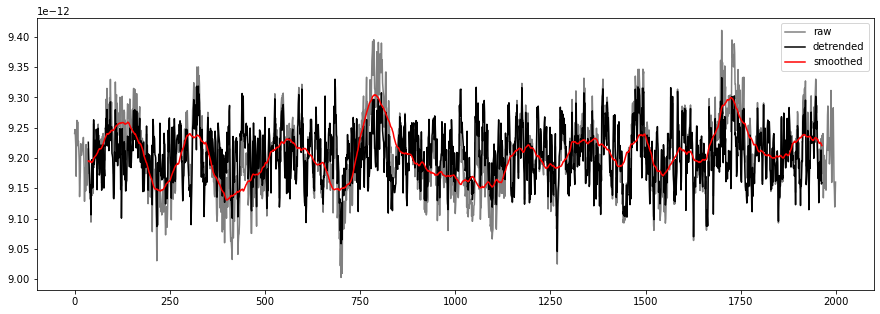

In [41]:
regioj = 'EQPac'
var = 'sos'

raw = timeSeries_oneVary[region][var]
smoothed = mfilter.smooth1d(raw, 71, mask_ends=True)
detrended = raw - (smoothed - smoothed.mean())

plt.figure(figsize=(15, 5))
plt.plot(raw, label='raw', color='grey')
plt.plot(detrended, label='detrended', color='k')
plt.plot(smoothed, label='smoothed', color='red')

plt.legend()